In [1]:
import string
import re
import numpy as np
from numpy.linalg import norm
import pandas as pd
from collections import Counter, OrderedDict

import seaborn as sns
import matplotlib.pyplot as plt

import nltk

from sklearn.feature_extraction import DictVectorizer

%matplotlib inline
pd.options.display.max_colwidth=500

In [2]:
# Load in training data and display in pandas dataframe
train_path='training.csv'
all_train_data = pd.read_csv(train_path,  delimiter="\t", skip_blank_lines = True)
test_path ='test.csv'
test_data = pd.read_csv(test_path,  delimiter="\t", skip_blank_lines = True)

# Inspect
all_train_data

,Episode,Scene,Scene_info,Character_name,Line,Gender
0,1350,1,DESERTED CAR PARK EXT NIGHT,SHIRLEY,"Look at ya, not a mark on ya. And you think you're an unlucky man.",FEMALE
1,1350,1,DESERTED CAR PARK EXT NIGHT,OTHER,Shirl...,MALE
2,1350,2,R&R INT NIGHT,JACK,Oi. Where have you been? Huh? What were the texts about?,MALE
3,1350,2,R&R INT NIGHT,RONNIE,Nothing. Nothing. I'll be with you in two minutes yeah?,FEMALE
4,1350,2,R&R INT NIGHT,JACK,"Well I've got mates here I wanted to have a chat with them, instead I've been serving behind the bar.",MALE
...,...,...,...,...,...,...
15314,1399,55,SQUARE EXT DAY LIGHT,OTHER,"Dad? Okay ... alright, just one drink alright. But that's all. It doesn't mean anything. It's just a drink.",MALE
15315,1399,55,SQUARE EXT DAY LIGHT,MAX,Thanks Bradley. Thanks mate... It means the world to me...,MALE
15316,1399,55,SQUARE EXT DAY LIGHT,OTHER,You alright...,MALE
15317,1399,55,SQUARE EXT DAY LIGHT,MAX,"Yeah, yeah, yeah. I'm fine.",MALE


In [3]:
# Split into training and test data for heldout validation with random samples of 9:1 train/heldout split
from random import shuffle, seed
# Set a seed for reproducibility so same split is used each time
seed(0) 

epsiode_scene_column = all_train_data.Episode.astype(str) + "-" + all_train_data.Scene.astype(str)
all_train_data['episode_scene'] = epsiode_scene_column
episode_scenes = sorted(list(set([x for x in epsiode_scene_column.values]))) # set function is random, need to sort!

shuffle(episode_scenes)

print(len(episode_scenes))
episode_split = int(0.9*len(episode_scenes))
training_ep_scenes = episode_scenes[:episode_split]
test_ep_scenes = episode_scenes[episode_split:]
print(len(training_ep_scenes), len(test_ep_scenes))

def train_or_heldout_eps(val):
    if val in training_ep_scenes:
        return "training"
    return "heldout"

all_train_data['train_heldout'] = all_train_data['episode_scene'].apply(train_or_heldout_eps)

1394
1254 140


In [4]:
print('Raw Data: ',np.shape(all_train_data))
train_data = all_train_data[all_train_data['train_heldout']=='training']
val_data = all_train_data[all_train_data['train_heldout']=='heldout']
print('Train set: ',np.shape(train_data))
print('Validation set: ',np.shape(val_data))

Raw Data:  (15319, 8)
Train set:  (13638, 8)
Validation set:  (1681, 8)


In [5]:
train_data

,Episode,Scene,Scene_info,Character_name,Line,Gender,episode_scene,train_heldout
0,1350,1,DESERTED CAR PARK EXT NIGHT,SHIRLEY,"Look at ya, not a mark on ya. And you think you're an unlucky man.",FEMALE,1350-1,training
1,1350,1,DESERTED CAR PARK EXT NIGHT,OTHER,Shirl...,MALE,1350-1,training
2,1350,2,R&R INT NIGHT,JACK,Oi. Where have you been? Huh? What were the texts about?,MALE,1350-2,training
3,1350,2,R&R INT NIGHT,RONNIE,Nothing. Nothing. I'll be with you in two minutes yeah?,FEMALE,1350-2,training
4,1350,2,R&R INT NIGHT,JACK,"Well I've got mates here I wanted to have a chat with them, instead I've been serving behind the bar.",MALE,1350-2,training
...,...,...,...,...,...,...,...,...
15314,1399,55,SQUARE EXT DAY LIGHT,OTHER,"Dad? Okay ... alright, just one drink alright. But that's all. It doesn't mean anything. It's just a drink.",MALE,1399-55,training
15315,1399,55,SQUARE EXT DAY LIGHT,MAX,Thanks Bradley. Thanks mate... It means the world to me...,MALE,1399-55,training
15316,1399,55,SQUARE EXT DAY LIGHT,OTHER,You alright...,MALE,1399-55,training
15317,1399,55,SQUARE EXT DAY LIGHT,MAX,"Yeah, yeah, yeah. I'm fine.",MALE,1399-55,training


In [6]:
if False:
    # A simpler alternative to the above, but where a high split means some characters
    # May be left out
    print('Raw Data: ',np.shape(all_train_data))
    idx = int(0.9 * np.shape(all_train_data)[0])
    train_data = all_train_data[:idx]
    val_data = all_train_data[idx:]
    print('Train set: ',np.shape(train_data))
    print('Validation set: ',np.shape(val_data))

In [23]:
def create_character_document_from_dataframe(df, max_line_count):
    """Returns a dict with the name of the character as key,
    their lines joined together as a single string, with end of line EOL
    markers between them.
    
    ::max_line_count:: the maximum number of lines to be added per character
    """
    character_docs = {}
    character_line_count = {}
    for index, data in enumerate(zip(df.Line, df.Character_name, df.Scene_info)):
        line = data[0]
        name = data[1]
        scene = data[2]
        
        #get the current episode
        episode =  df.Episode.values[index]
        
        next_scene = ""
        next_line = ""
        previous_scene = ""
        previous_line = ""
        
        if index > 0:
            previous_scene = df.Scene_info.values[index-1]
            #Adding the previous line
            if scene == previous_scene:
                previous_line =  str(df.Line.values[index-1]) + " PRE "
        
        if index < len(df.Line) - 1:
            next_scene = df.Scene_info.values[index+1]
            #Adding the next line
            if scene == next_scene:
                next_line = str(df.Line.values[index+1]) + " NEXT "
        
        if not name in character_docs.keys():
            character_docs[name] = ""
            character_line_count[name] = 0
        
        if character_line_count[name]==max_line_count:
            continue
        
        character_docs[name] += str(episode) + " EPISODE " + pre_line + str(line) + next_line + " EOL "
        character_line_count[name]+=1
    print("lines per character", character_line_count)
    return character_docs

In [24]:
# Print out the number of words each character has in the training set
# Only use the first 360 lines of each character
train_character_docs = create_character_document_from_dataframe(train_data, max_line_count=360)
print('Num. Characters: ',len(train_character_docs.keys()),"\n")
total_words = 0
for name in train_character_docs.keys():
    print(name, 'Number of Words: ',len(train_character_docs[name].split()))
    total_words += len(train_character_docs[name].split())
print("total words", total_words)

lines per character {'SHIRLEY': 360, 'OTHER': 360, 'JACK': 360, 'RONNIE': 360, 'TANYA': 360, 'SEAN': 360, 'ROXY': 360, 'HEATHER': 360, 'MAX': 360, 'IAN': 360, 'JANE': 360, 'STACEY': 360, 'PHIL': 360, 'MINTY': 360, 'CHRISTIAN': 342, 'CLARE': 352}
Num. Characters:  16 

SHIRLEY Number of Words:  11076
OTHER Number of Words:  9319
JACK Number of Words:  11188
RONNIE Number of Words:  11398
TANYA Number of Words:  10785
SEAN Number of Words:  10739
ROXY Number of Words:  11217
HEATHER Number of Words:  11835
MAX Number of Words:  11375
IAN Number of Words:  11742
JANE Number of Words:  11154
STACEY Number of Words:  11304
PHIL Number of Words:  12111
MINTY Number of Words:  12100
CHRISTIAN Number of Words:  10783
CLARE Number of Words:  11298
total words 179424


In [25]:
from nltk.stem import WordNetLemmatizer 
from nltk.stem.porter import PorterStemmer
from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize 
import string
import re
import num2words

def pre_process(character_text):
    
    tokens_list = [] #Empty list to store tokens
    
    token = re.sub(r'\b\d+\b', '', character_text)
    new_token = re.sub(r'[^\w\s]', '', token)
    
    tokens = nltk.word_tokenize(new_token)
    
    #Initialize the lemmatizer 
    lm = WordNetLemmatizer()
    
    #Initialize the Porter Stemmer
    ps = PorterStemmer()
    
    for token in tokens:
        #Used in task 3 for pre processing of previous and next line
        if token != '_EOL_' or token != '<PRE>' or token != '<PRE/>' or token != '<NEXT>' or token != '<NEXT/>':
            token = re.sub(r'[^\w\s]', '', token) #End of task 3 for pre processing of previous and next line
        
        #Converted into lowercase
        word = token.lower()
        
        # Get the base of the word
        token = lm.lemmatize(token)
        
        #Get the stemmed word
        token = ps.stem(token)
        
        #To remove the stop words
        if token not in set(stopwords.words("english")):
            if token != '' and len(token) > 1 and not token.isdigit():
                tokens_list.append(token)
    
    return tokens_list

In [26]:
# Creating list of pairs of (character name, pre-processed character) 
training_corpus = [(name, pre_process(doc)) for name, doc in sorted(train_character_docs.items())]
train_labels = [name for name, doc in training_corpus]

In [27]:
from nltk import pos_tag

def to_feature_vector_dictionary(character_doc, extra_features=[]):

    extra_features = [] #add features to the list
    
    for index, token in enumerate(character_doc):
        pos_tag = nltk.pos_tag([token]) #get the pos tag for the token
        
        extra_features.append(token + "@" + pos_tag[0][1])

        if index > 0:
            # Get the previous token for the current word
            extra_features.append(token + "@" + character_doc[index-1])  
            
            # Get the pos tag for the previous token 
            pre_pos_tag = nltk.pos_tag([character_doc[index-1]])  
            
            extra_features.append(token + "@" + pre_pos_tag[0][1])

        if index > 1:
            # Get the previous to previous token for the current word
            extra_features.append(token + "@" + character_doc[index-2])
            
            # Get the pos tag for the previous to previous token
            pre2_pos_tag = nltk.pos_tag([character_doc[index-2]])
            
            extra_features.append(token + "@" + pre2_pos_tag[0][1])

        if index < len(character_doc) - 1:
            # Get the next token for the current word
            extra_features.append(token + "@" + character_doc[index+1])  
            
            # Get the pos tag for the next token
            next_pos_tag = nltk.pos_tag([character_doc[index+1]])  
            
            extra_features.append(token + "@" + next_pos_tag[0][1])
        
        if index < len(character_doc) - 2:
            # Get the next to next token for the current word
            extra_features.append(
                token + "@" + character_doc[index+2])
            # Get the pos tag for the next to next token
            next_pos_tag = nltk.pos_tag(
                [character_doc[index+2]])  
            extra_features.append(token + "@" + next_pos_tag[0][1])

    character_doc.extend(extra_features)
    
    #Count of the fetures
    count = Counter(character_doc)
    result = dict(count)
    new_result = dict()
    for key, value in zip(result.keys(), result.values()):
        new_result[key] = value
    
    return new_result

In [28]:
# corpusVectorizor which produces sparse vectors from feature dicts
corpusVectorizer = DictVectorizer()
# Any matrix transformers should initiate here
# initializing tf-idf transformer
from sklearn.feature_extraction.text import TfidfTransformer
tfidf_transformer = TfidfTransformer()

def create_document_matrix_from_corpus(corpus, fitting=False):
    """Method which fits different vectorizers
    on data and returns a matrix.
    
    Currently just does simple conversion to matrix by vectorizing the dictionary. Improve this for Q3.
    
    ::corpus:: a list of (class_label, document) pairs.
    ::fitting:: a boolean indicating whether to fit/train the vectorizers (should be true on training data)
    """
    
    # Uses the global variable of the corpus Vectorizer to improve things
    if fitting:
        corpusVectorizer.fit([to_feature_vector_dictionary(doc) for name, doc in corpus])
    doc_feature_matrix = corpusVectorizer.transform([to_feature_vector_dictionary(doc) for name, doc in corpus])
    
    if fitting:
        tfidf_transformer.fit(doc_feature_matrix)
    doc_feature_matrix = tfidf_transformer.transform(doc_feature_matrix)
    
    return doc_feature_matrix

training_feature_matrix = create_document_matrix_from_corpus(training_corpus, fitting=True)

['episod', 'yeah', 'point', 'millionth', 'time', 'youv', 'said', 'pre', 'lesley', 'im', 'realli', 'glad', 'thi', 'must', 'ianyeah', 'hi', 'next', 'eol', 'episod', 'yeah', 'hi', 'pre', 'thi', 'partner', 'ashleyoh', 'pleas', 'meet', 'next', 'eol', 'episod', 'hi', 'asley', 'nice', 'meet', 'um', 'thi', 'tabl', 'want', 'sit', 'pre', 'love', 'littl', 'placeso', 'youv', 'seen', 'flesh', 'ashley', 'doe', 'lesley', 'compar', 'way', 'describ', 'next', 'eol', 'episod', 'love', 'littl', 'place', 'pre', 'youv', 'seen', 'flesh', 'ashley', 'doe', 'lesley', 'compar', 'way', 'describ', 'herit', 'jane', 'nowaday', 'thank', 'christian', 'next', 'eol', 'episod', 'jane', 'nowaday', 'thank', 'christian', 'pre', 'keep', 'forget', 'lesley', 'chang', 'name', 'would', 'therapist', 'bloke', 'make', 'thatim', 'sure', 'hed', 'make', 'anyth', 'next', 'eol', 'episod', 'im', 'sure', 'hed', 'make', 'anyth', 'pre', 'might', 'say', 'indic', 'attempt', 'run', 'away', 'somethingbut', 'let', 'go', 'nowso', 'ashley', 'chris

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [29]:
training_feature_matrix

<16x179682 sparse matrix of type '<class 'numpy.float64'>'
	with 326696 stored elements in Compressed Sparse Row format>

In [30]:
# get the validation data- only 40 lines used for each character
val_character_docs = create_character_document_from_dataframe(val_data, max_line_count=40)
print('Num. Characters: ',len(val_character_docs.keys()),"\n")
total_words = 0
for name in val_character_docs.keys():
    print(name, 'Num of Words: ',len(val_character_docs[name].split()))
    total_words += len(val_character_docs[name].split())
print("total words", total_words)

# create list of pairs of (character name, pre-processed character) 
val_corpus = [(name, pre_process(doc)) for name, doc in sorted(val_character_docs.items())]
val_labels = [name for name, doc in val_corpus]

lines per character {'TANYA': 40, 'MAX': 40, 'SEAN': 35, 'SHIRLEY': 40, 'OTHER': 40, 'STACEY': 40, 'RONNIE': 40, 'JACK': 40, 'PHIL': 40, 'IAN': 40, 'JANE': 40, 'ROXY': 40, 'HEATHER': 40, 'MINTY': 40, 'CHRISTIAN': 40, 'CLARE': 40}
Num. Characters:  16 

TANYA Num of Words:  1260
MAX Num of Words:  1601
SEAN Num of Words:  1001
SHIRLEY Num of Words:  1263
OTHER Num of Words:  864
STACEY Num of Words:  1377
RONNIE Num of Words:  1125
JACK Num of Words:  1071
PHIL Num of Words:  1270
IAN Num of Words:  1299
JANE Num of Words:  1306
ROXY Num of Words:  1172
HEATHER Num of Words:  1160
MINTY Num of Words:  1443
CHRISTIAN Num of Words:  1159
CLARE Num of Words:  1384
total words 19755


In [31]:
# Just transform the val_feature_matrix, don't fit
val_feature_matrix = create_document_matrix_from_corpus(val_corpus, fitting=False)

['episod', 'shifti', 'slimey', 'littl', 'pre', 'cheap', 'aftershavethink', 'run', 'chip', 'shop', 'nutswho', 'jack', 'next', 'eol', 'episod', 'jack', 'pre', 'ian', 'bealemi', 'sister', 'aint', 'go', 'ian', 'beal', 'next', 'eol', 'episod', 'sister', 'aint', 'go', 'ian', 'beal', 'pre', 'think', 'lucki', 'mine', 'marri', 'christian', 'jane', 'brotherah', 'poor', 'thing', 'roxi', 'mitchel', 'next', 'eol', 'episod', 'cours', 'know', 'nearli', 'didnt', 'marri', 'beal', 'pre', 'comethey', 'call', 'first', 'wed', 'didnt', 'next', 'eol', 'episod', 'call', 'first', 'wed', 'didnt', 'pre', 'theyjan', 'affair', 'next', 'eol', 'episod', 'jane', 'affair', 'pre', 'sisterwith', 'cousin', 'grant', 'next', 'eol', 'episod', 'cousin', 'grant', 'pre', 'kept', 'one', 'quiet', 'like', 'thi', 'granthav', 'seen', 'year', 'couldnt', 'differ', 'ian', 'mean', 'ysed', 'para', 'next', 'eol', 'episod', 'go', 'pre', 'gay', 'bar', 'know', 'barmaid', 'fanci', 'janewer', 'go', 'rr', 'next', 'eol', 'episod', 'coupl', 'dri

In [32]:
val_feature_matrix

<16x179682 sparse matrix of type '<class 'numpy.float64'>'
	with 29332 stored elements in Compressed Sparse Row format>

In [33]:
def compute_cosine_similarity(v1, v2):
    """Takes a pair of vectors v1 and v2 (1-d arrays e.g. [0, 0.5, 0.5])
    returns the cosine similarity between the vectors
    """
    
    # compute cosine similarity manually
    manual_cosine_similarity = np.dot(v1, v2)  /(norm(v1) * norm(v2))
    
    return manual_cosine_similarity

In [34]:
def compute_IR_evaluation_scores(train_feature_matrix, test_feature_matrix, train_labels, test_labels):
    """
    Computes an information retrieval based on training data feature matrix and test data feature matrix
    returns 4-tuple:
    ::mean_rank:: mean of the ranking of the target document in terms of similarity to the query/test document
    1 is the best possible score.
    ::mean_cosine_similarity:: mean cosine similarity score for the target document vs. the test document of the same class
    ::accuracy:: proportion of test documents correctly classified
    ::df:: a data frame with all the similarity measures of the test documents vs. train documents
    
    params:
    ::train_feature_matrix:: a numpy matrix N x M shape where N = number of characters M = number of features
    ::test_feature_matrix::  a numpy matrix N x M shape where N = number of characters M = number of features
    ::train_labels:: a list of character names for the training data in order consistent with train_feature_matrix
    ::test_labels:: a list of character names for the test data in order consistent with test_feature_matrix
    """
    rankings = []
    all_cosine_similarities = []
    pairwise_cosine_similarity = []
    pairs = []
    correct = 0
    for i, target in enumerate(test_labels):
        # compare the left out character against the mean
        idx = i 
        fm_1 = test_feature_matrix.toarray()[idx]
        all_sims = {}
        # print("target:", target)
        for j, other in enumerate(train_labels):
            fm_2 = train_feature_matrix.toarray()[j]
            manual_cosine_similarity = compute_cosine_similarity(fm_1, fm_2)
            pairs.append((target, other))
            pairwise_cosine_similarity.append(manual_cosine_similarity)
            if other == target:
                all_cosine_similarities.append(manual_cosine_similarity)
            all_sims[other] = manual_cosine_similarity

            # print(target, other, manual_cosine_similarity)
        sorted_similarities = sorted(all_sims.items(),key=lambda x:x[1],reverse=True)
        # print(sorted_similarities)
        ranking = {key[0]: rank for rank, key in enumerate(sorted_similarities, 1)}
        # print("Ranking for target", ranking[target])
        if ranking[target] == 1:
            correct += 1
        rankings.append(ranking[target])
        # print("*****")
    mean_rank = np.mean(rankings)
    mean_cosine_similarity = np.mean(all_cosine_similarities)
    accuracy = correct/len(test_labels)
    print("mean rank", np.mean(rankings))
    print("mean cosine similarity", mean_cosine_similarity)
    print(correct, "correct out of", len(test_labels), "/ accuracy:", accuracy )
    
    # get a dafaframe showing all the similarity scores of training vs test docs
    df = pd.DataFrame({'doc1': [x[0] for x in pairs], 'doc2': [x[1] for x in pairs],
                       'similarity': pairwise_cosine_similarity})

    # display characters which are most similar and least similar
    df.loc[[df.similarity.values.argmax(), df.similarity.values.argmin()]]
    return (mean_rank, mean_cosine_similarity, accuracy, df)

In [35]:
def plot_heat_map_similarity(df):
    """Takes a dataframe with header 'doc1, doc2, similarity'
    Plots a heatmap based on the similarity scores.
    """
    test_labels =  sorted(list(set(df.sort_values(['doc1'])['doc1'])))
    # add padding 1.0 values to either side
    cm = [[1.0,] * (len(test_labels)+2)]
    for target in test_labels:
        new_row = [1.0]
        for x in df.sort_values(['doc1', 'doc2'])[df['doc1']==target]['similarity']:
            new_row.append(x)
        new_row.append(1.0)
        cm.append(new_row)
    cm.append([1.0,] * (len(test_labels)+2))
    #print(cm)
    labels = [""] + test_labels + [""]
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(111)
    cax = ax.matshow(cm)
    plt.title('Similarity matrix between documents as vectors')
    fig.colorbar(cax)
    ax.set_xticks(np.arange(len(labels)))
    ax.set_yticks(np.arange(len(labels)))
    ax.set_xticklabels( labels, rotation=45)
    ax.set_yticklabels( labels)

    for i in range(len(cm)):
        for j in range(len(cm)):

            text = ax.text(j, i, round(cm[i][j],3),
                           ha="center", va="center", color="w")

    plt.xlabel('Training Vector Doc')
    plt.ylabel('Test Vector Doc')
    #fig.tight_layout()
    plt.show()

In [36]:
mean_rank, mean_cosine_simliarity, acc, df = compute_IR_evaluation_scores(training_feature_matrix, val_feature_matrix, train_labels, val_labels)

mean rank 1.625
mean cosine similarity 0.8370302216288212
9 correct out of 16 / accuracy: 0.5625


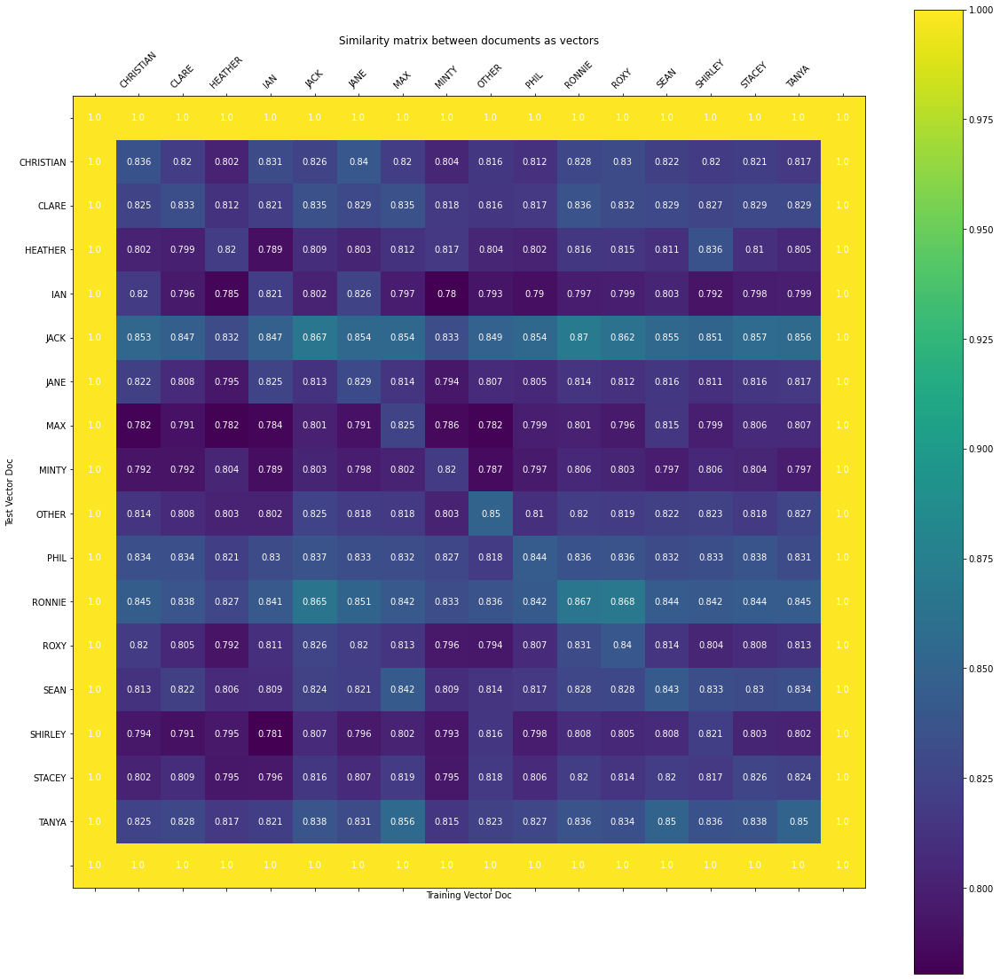

In [37]:
plot_heat_map_similarity(df)

In [38]:
# redo on all training data with the first 400 character lines used
train_character_docs = create_character_document_from_dataframe(all_train_data, max_line_count=400)
print('Num. Characters: ',len(train_character_docs.keys()),"\n")
total_words = 0
for name in train_character_docs.keys():
    print(name, 'Number of Words: ',len(train_character_docs[name].split()))
    total_words += len(train_character_docs[name].split())
print("total words", total_words)

training_corpus = [(name, pre_process(doc)) for name, doc in train_character_docs.items()]
train_labels = [name for name, doc in training_corpus]

corpusVectorizer = DictVectorizer()   # initialize a corpusVectorizor which will output sparse vectors from dicts
# Any matrix transformers (e.g. tf-idf transformers) should be initialized here
tfidf_transformer = TfidfTransformer()

training_feature_matrix = create_document_matrix_from_corpus(training_corpus, fitting=True)

# get the test data using 40 lines per character
test_character_docs = create_character_document_from_dataframe(test_data, max_line_count=40)
print('Num. Characters: ',len(test_character_docs.keys()),"\n")
total_words = 0
for name in test_character_docs.keys():
    print(name, 'Number of Words: ',len(test_character_docs[name].split()))
    total_words += len(test_character_docs[name].split())
print("total words", total_words)

# create list of pairs of (character name, pre-processed character) 
test_corpus = [(name, pre_process(doc)) for name, doc in test_character_docs.items()]
test_labels = [name for name, doc in test_corpus]


# Just transform the val_feature_matrix, don't fit
test_feature_matrix = create_document_matrix_from_corpus(test_corpus, fitting=False)


mean_rank, mean_cosine_simliarity, acc, df = compute_IR_evaluation_scores(training_feature_matrix, test_feature_matrix, train_labels, test_labels)

lines per character {'SHIRLEY': 400, 'OTHER': 400, 'JACK': 400, 'RONNIE': 400, 'TANYA': 400, 'SEAN': 400, 'ROXY': 400, 'HEATHER': 400, 'MAX': 400, 'IAN': 400, 'JANE': 400, 'STACEY': 400, 'PHIL': 400, 'MINTY': 400, 'CHRISTIAN': 385, 'CLARE': 400}
Num. Characters:  16 

SHIRLEY Number of Words:  12317
OTHER Number of Words:  10212
JACK Number of Words:  12259
RONNIE Number of Words:  12652
TANYA Number of Words:  11781
SEAN Number of Words:  12042
ROXY Number of Words:  12397
HEATHER Number of Words:  12943
MAX Number of Words:  12914
IAN Number of Words:  13130
JANE Number of Words:  12469
STACEY Number of Words:  12582
PHIL Number of Words:  13337
MINTY Number of Words:  13490
CHRISTIAN Number of Words:  11992
CLARE Number of Words:  12938
total words 199455
['episod', 'look', 'ya', 'mark', 'ya', 'think', 'unlucki', 'manshirl', 'next', 'eol', 'episod', 'go', 'pre', 'im', 'gon', 'na', 'get', 'help', 'oh', 'phone', 'oh', 'kevin', 'kevin', 'smash', 'didnt', 'ya', 'kevin', 'kevin', 'phonei

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



lines per character {'SHIRLEY': 40, 'OTHER': 40, 'HEATHER': 40, 'PHIL': 40, 'SEAN': 40, 'TANYA': 40, 'MAX': 40, 'JACK': 40, 'IAN': 40, 'JANE': 40, 'STACEY': 40, 'ROXY': 40, 'RONNIE': 40, 'CHRISTIAN': 40, 'MINTY': 40, 'CLARE': 40}
Num. Characters:  16 

SHIRLEY Number of Words:  1311
OTHER Number of Words:  1211
HEATHER Number of Words:  1109
PHIL Number of Words:  1352
SEAN Number of Words:  1276
TANYA Number of Words:  1198
MAX Number of Words:  1187
JACK Number of Words:  1132
IAN Number of Words:  1367
JANE Number of Words:  1263
STACEY Number of Words:  1415
ROXY Number of Words:  1110
RONNIE Number of Words:  1148
CHRISTIAN Number of Words:  1385
MINTY Number of Words:  1439
CLARE Number of Words:  1086
total words 19989
['episod', 'youll', 'alright', 'kevin', 'theyr', 'gon', 'na', 'cut', 'go', 'alright', 'come', 'talk', 'talk', 'call', 'name', 'let', 'know', 'still', 'meiv', 'got', 'pin', 'needl', 'finger', 'next', 'eol', 'episod', 'ive', 'got', 'pin', 'needl', 'finger', 'pre', '